In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Import necessary libraries.
import os
import glob
import imageio
import random, shutil
import torch
import torch.nn as nn
from tqdm.notebook import tqdm
import torch.nn.functional as F
import torchvision.datasets as datasets
from torchvision.utils import make_grid
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as display

### **Reading Dataset**

In [ ]:
train_dir='/content/drive/MyDrive/COVID 19 DATASET/COVID-19/COVID-19/train'
val_dir= '/content/drive/MyDrive/COVID 19 DATASET/COVID-19/COVID-19/val'

In [ ]:
train_dataset = datasets.ImageFolder(
    train_dir,
    transforms.Compose([transforms.Resize( (256,256)) ,
        transforms.ToTensor(),
    ]))

train_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=128, shuffle=True, num_workers=0)

val_dataset = datasets.ImageFolder(
    val_dir,
    transforms.Compose([
        transforms.ToTensor(),
    ]))

val_loader = torch.utils.data.DataLoader(
    val_dataset, batch_size=128, shuffle=True, num_workers=0)

In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

### **Generator **

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
                                    self.make_gen_block(z_dim, hidden_dim * 4),
                                    self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
                                    self.make_gen_block(hidden_dim * 2, hidden_dim),
                                    self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
                                )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN,
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''

        #     Steps:
        #       1) Do a transposed convolution using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a ReLU activation.
        #       4) If its the final layer, use a Tanh activation after the deconvolution.

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU()
                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh()
                #### END CODE HERE ####
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return noise.view( len(noise), self.z_dim , 1 , 1 ) # num of samples , z_dim , h , w

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

### **Discriminator**

In [ ]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
    hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=3, hidden_dim=16):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
                                    self.make_disc_block(im_chan, hidden_dim),
                                    self.make_disc_block(hidden_dim, hidden_dim * 2),
                                    self.make_disc_block(hidden_dim * 2 , 1 , final_layer=True),
                                )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of DCGAN,
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''
        #     Steps:
        #       1) Add a convolutional layer using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a LeakyReLU activation with slope 0.2.

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2)
                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels, output_channels, kernel_size, stride)

                #### END CODE HERE ####
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor,
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

In [ ]:
criterion = nn.BCEWithLogitsLoss()
z_dim = 64
display_step = 500
batch_size = 128
# A learning rate of 0.0002 works well on DCGAN
lr = 0.0002

# These parameters control the optimizer's momentum, which you can read more about here:
# https://distill.pub/2017/momentum/ but you don’t need to worry about it for this course!
beta_1 = 0.5
beta_2 = 0.999
device = 'cuda'

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))

# You initialize the weights to the normal distribution
# with mean 0 and standard deviation 0.02
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Step 200: Generator loss: 0.2745787876844407, discriminator loss: 0.2752260856628418


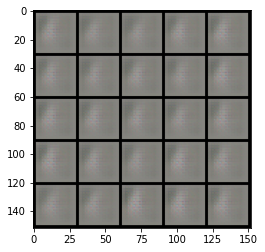

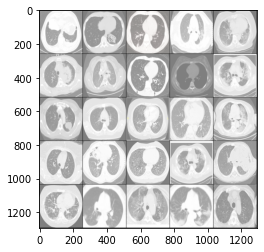

Step 400: Generator loss: 0.277003485441208, discriminator loss: 0.27340306699275957


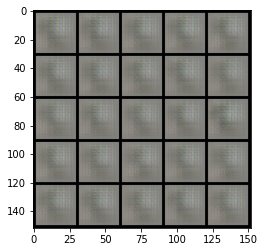

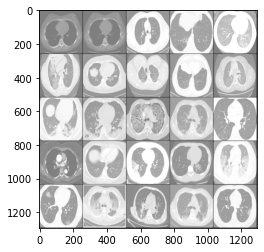

Step 600: Generator loss: 0.2892008616924286, discriminator loss: 0.2683964867591859


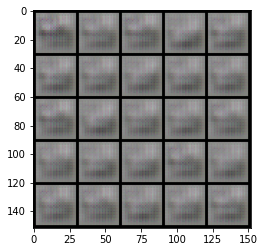

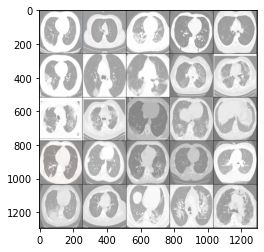

Step 800: Generator loss: 0.28746338474750516, discriminator loss: 0.27163663244247443


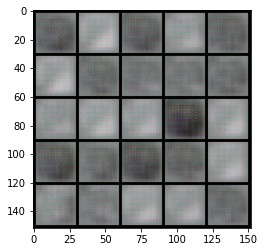

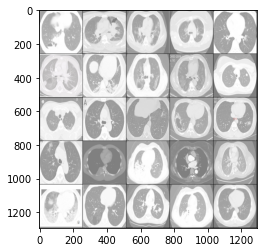

Step 1000: Generator loss: 0.2811463916301729, discriminator loss: 0.2778140032291413


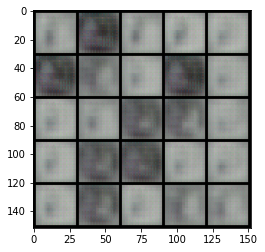

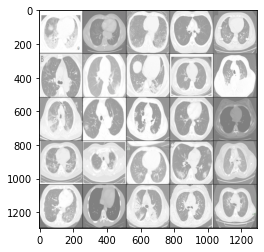

Step 1200: Generator loss: 0.28032367944717407, discriminator loss: 0.27730781686305994


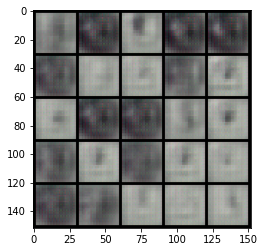

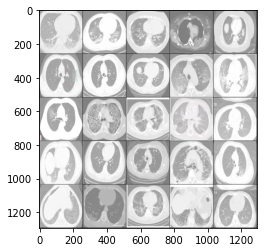

Step 1400: Generator loss: 0.278036186337471, discriminator loss: 0.27666998541355126


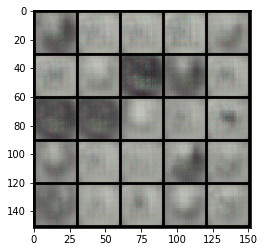

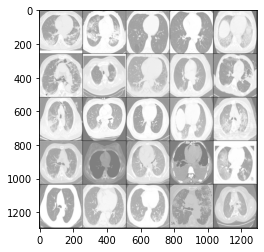

Step 1600: Generator loss: 0.27906108224391946, discriminator loss: 0.27671523475647


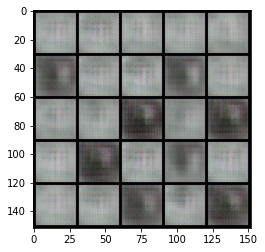

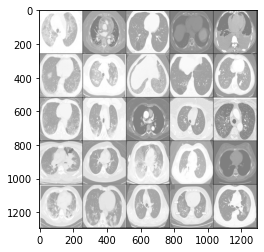

Step 1800: Generator loss: 0.2789788401126862, discriminator loss: 0.27657614958286286


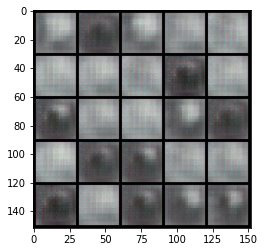

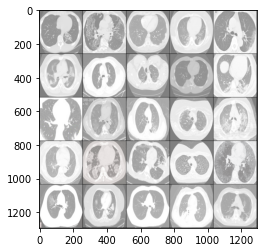

Step 2000: Generator loss: 0.2796181092262268, discriminator loss: 0.27657054126262665


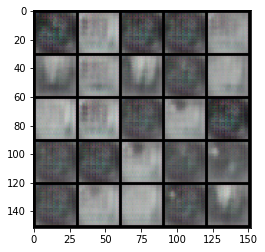

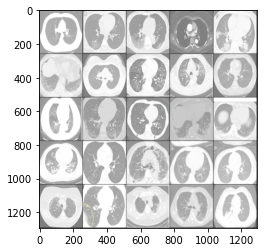

Step 2200: Generator loss: 0.27912921261787405, discriminator loss: 0.27677043354511255


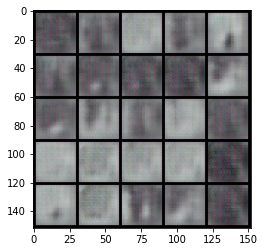

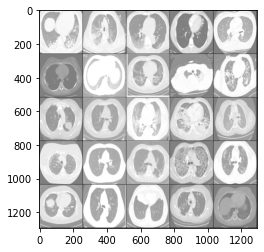

Step 2400: Generator loss: 0.27798669278621674, discriminator loss: 0.27718437850475314


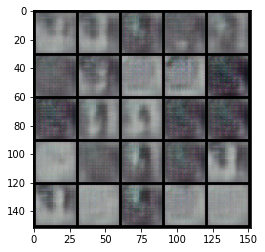

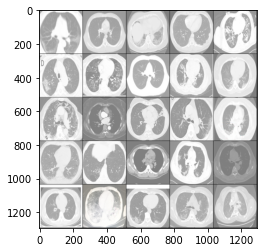

Step 2600: Generator loss: 0.27792988634109483, discriminator loss: 0.27717852270603177


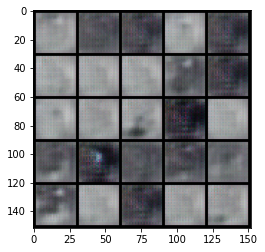

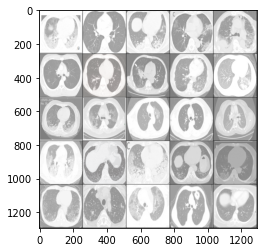

Step 2800: Generator loss: 0.2789030152559282, discriminator loss: 0.2770081647634507


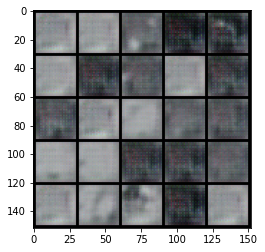

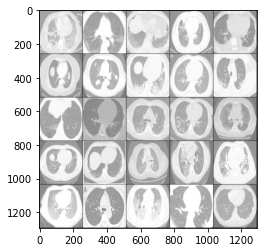

Step 3000: Generator loss: 0.27875308084487915, discriminator loss: 0.2770592972040175


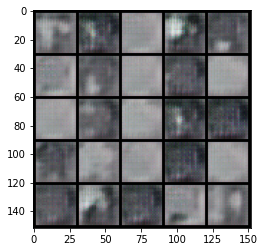

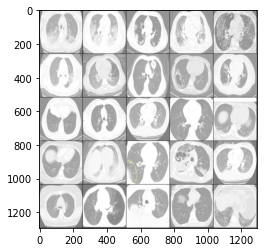

Step 3200: Generator loss: 0.2793334592580795, discriminator loss: 0.2772726094722747


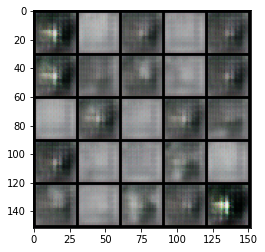

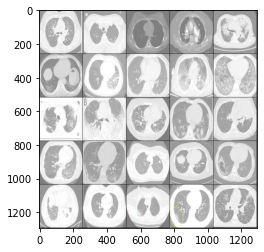

Step 3400: Generator loss: 0.2793098355531693, discriminator loss: 0.2771006031036377


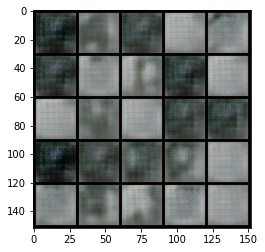

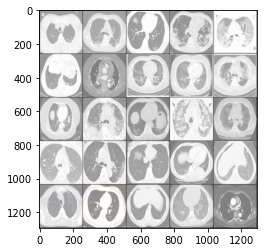

Step 3600: Generator loss: 0.27912938654422753, discriminator loss: 0.2772747050523757


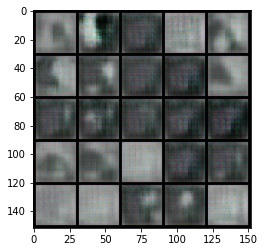

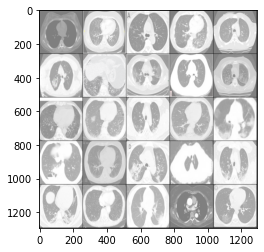

Step 3800: Generator loss: 0.2789139158725737, discriminator loss: 0.2771887353658675


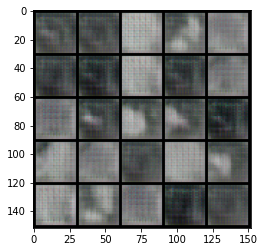

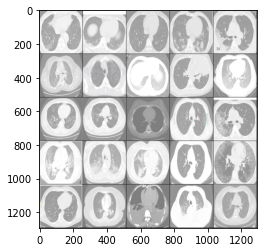

Step 4000: Generator loss: 0.27863810312747955, discriminator loss: 0.27714896285533913


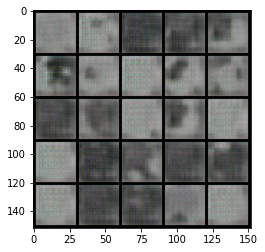

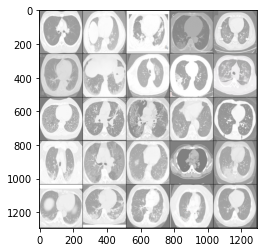

Step 4200: Generator loss: 0.27785425221919996, discriminator loss: 0.2773082400560378


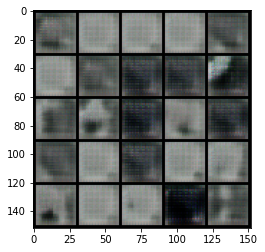

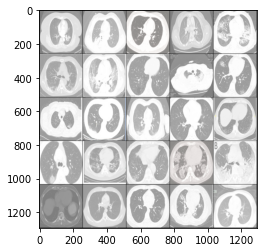

Step 4400: Generator loss: 0.27765381669998174, discriminator loss: 0.27752349948883054


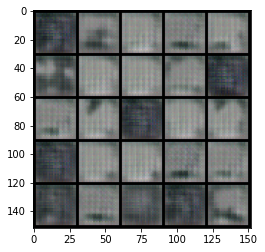

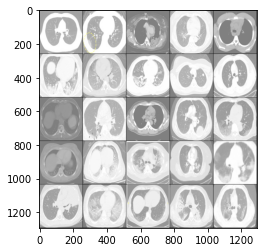

Step 4600: Generator loss: 0.2779654898643495, discriminator loss: 0.27739051580429086


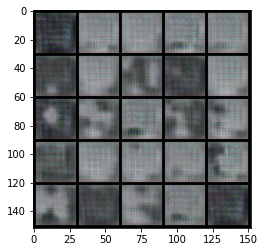

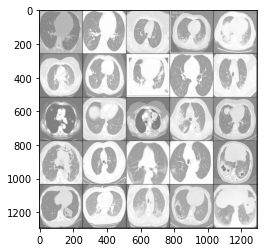

Step 4800: Generator loss: 0.27835576415061936, discriminator loss: 0.2772648522853851


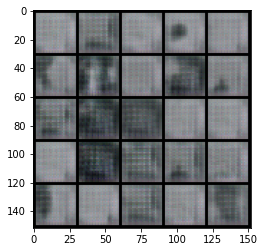

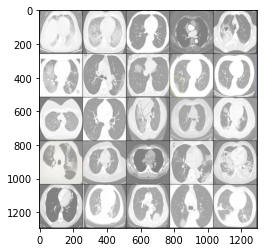

Step 5000: Generator loss: 0.2777384557724, discriminator loss: 0.2774227235317232


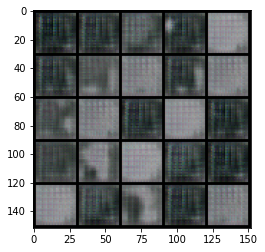

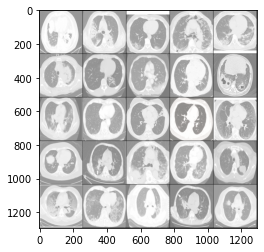

Step 5200: Generator loss: 0.278059117078781, discriminator loss: 0.27743824839591985


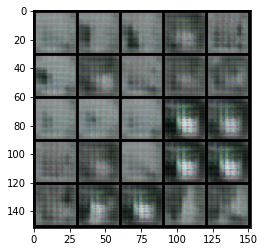

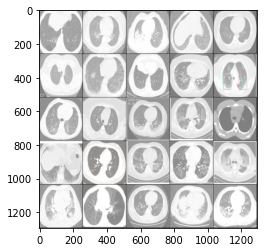

Step 5400: Generator loss: 0.2790850040912629, discriminator loss: 0.2768494161367415


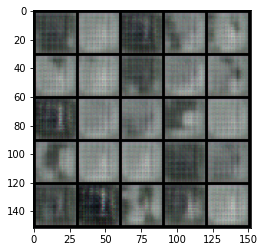

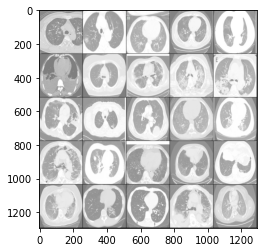

Step 5600: Generator loss: 0.2776662913560869, discriminator loss: 0.2777013611793518


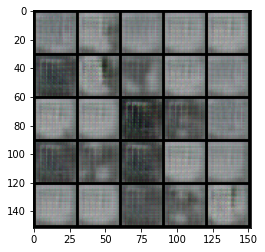

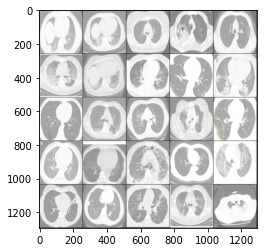

Step 5800: Generator loss: 0.2774073835611342, discriminator loss: 0.2775244542360304


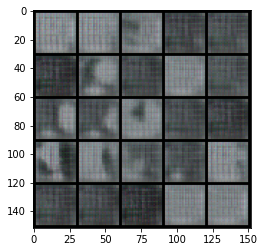

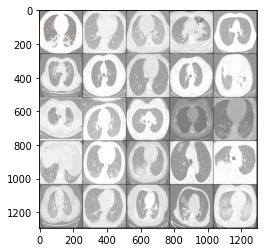

Step 6000: Generator loss: 0.27737283098697657, discriminator loss: 0.27735492956638325


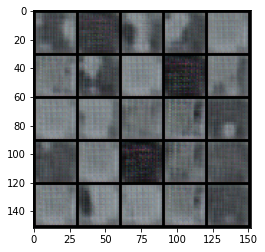

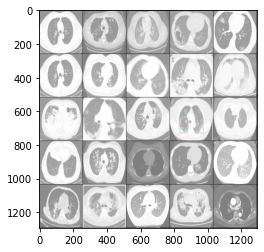

Step 6200: Generator loss: 0.2776018850803374, discriminator loss: 0.27744504094123856


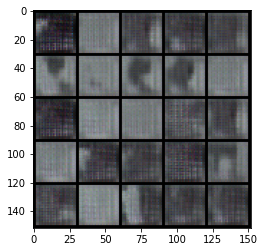

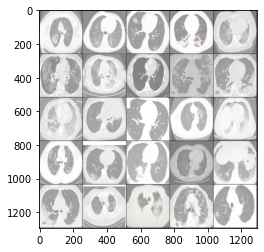

Step 6400: Generator loss: 0.2777580637931825, discriminator loss: 0.27736267387866964


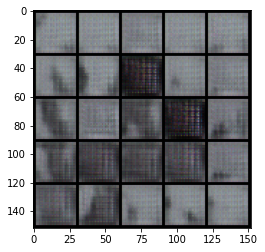

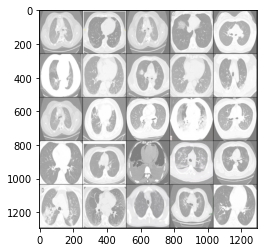

Step 6600: Generator loss: 0.27724842202663436, discriminator loss: 0.27741548967361457


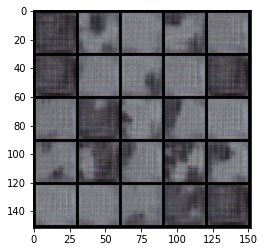

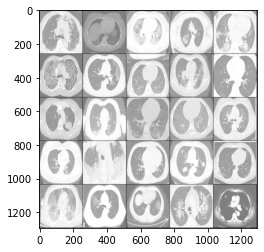

Step 6800: Generator loss: 0.27770581173896786, discriminator loss: 0.27731155884265907


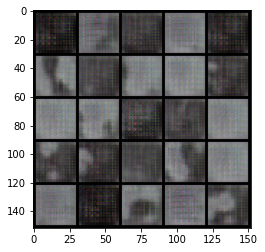

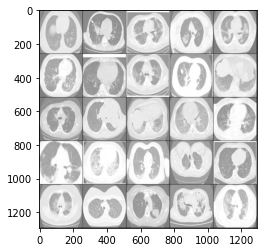

Step 7000: Generator loss: 0.2777327977418899, discriminator loss: 0.27729741692543025


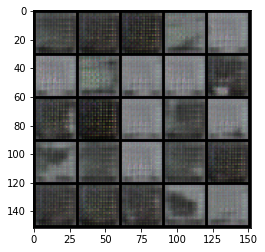

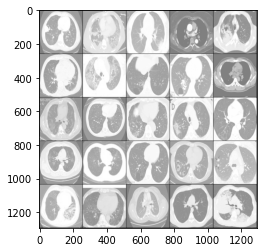

Step 7200: Generator loss: 0.2781492843627927, discriminator loss: 0.27723812448978413


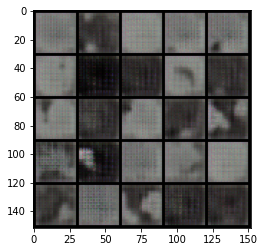

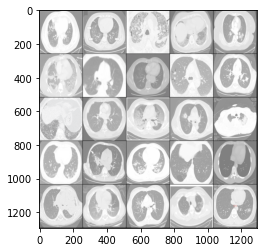

Step 7400: Generator loss: 0.2779955649375916, discriminator loss: 0.27723833668231973


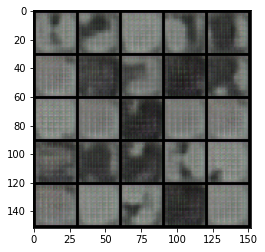

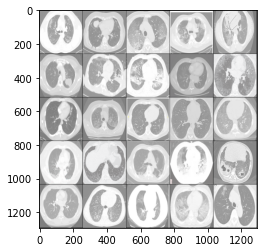

Step 7600: Generator loss: 0.27790289986133593, discriminator loss: 0.27729404401779156


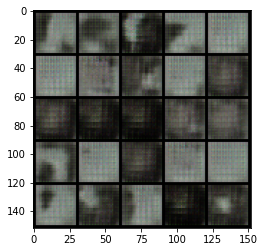

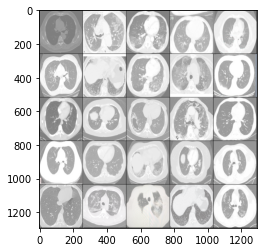

Step 7800: Generator loss: 0.27783781838417043, discriminator loss: 0.2773377869129182


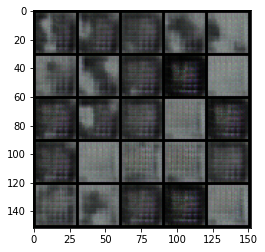

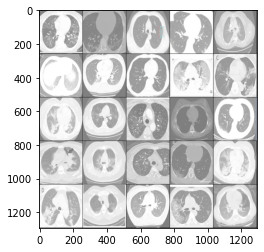

Step 8000: Generator loss: 0.2784338841438294, discriminator loss: 0.2772678799629211


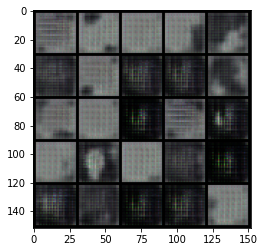

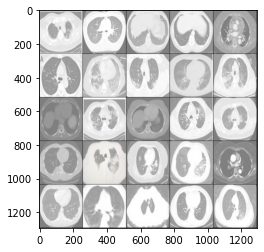

Step 8200: Generator loss: 0.27740243649482743, discriminator loss: 0.27734699559211723


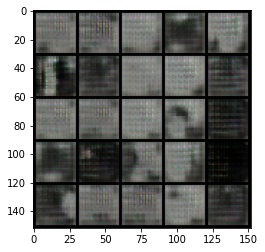

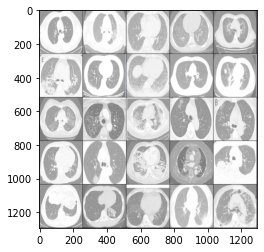

Step 8400: Generator loss: 0.27776638042926766, discriminator loss: 0.2773851426839828


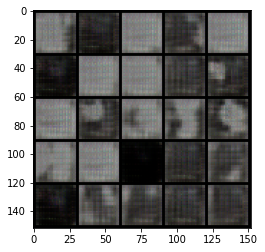

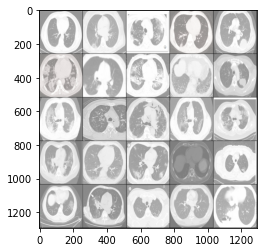

Step 8600: Generator loss: 0.27766747629642485, discriminator loss: 0.27732845544815055


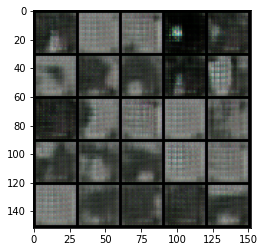

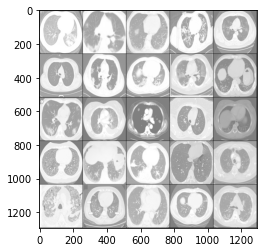

Step 8800: Generator loss: 0.27793626058101667, discriminator loss: 0.2772940734624864


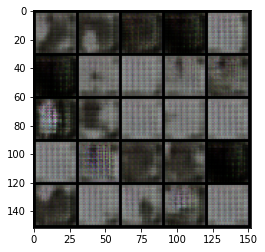

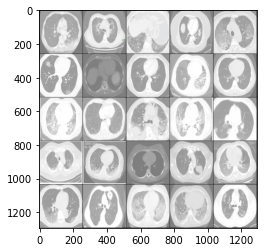

Step 9000: Generator loss: 0.2778308418989182, discriminator loss: 0.2774308581352233


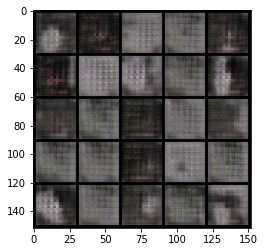

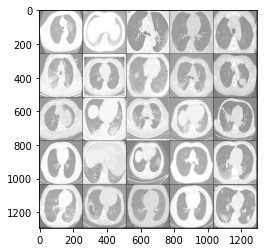

Step 9200: Generator loss: 0.27787452769279486, discriminator loss: 0.2774649173021316


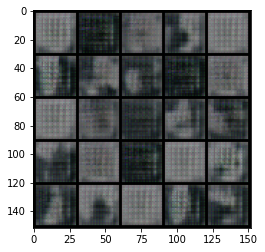

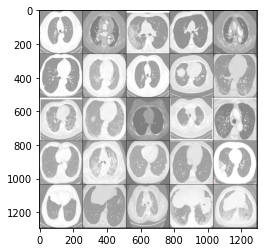

Step 9400: Generator loss: 0.27820099091529854, discriminator loss: 0.2771119562387466


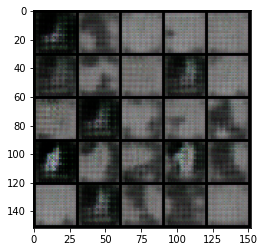

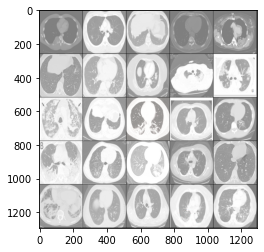

Step 9600: Generator loss: 0.2778435219526291, discriminator loss: 0.2774532216787339


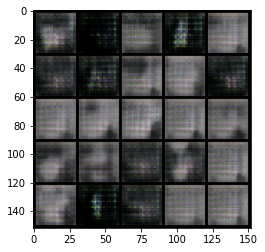

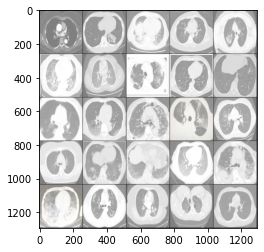

Step 9800: Generator loss: 0.2778037804365157, discriminator loss: 0.27727334487438204


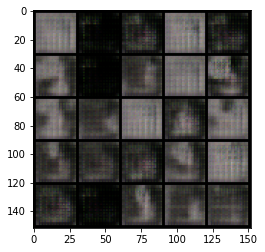

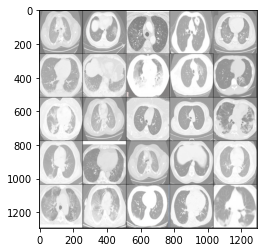

Step 10000: Generator loss: 0.2778857421874998, discriminator loss: 0.27708054518699654


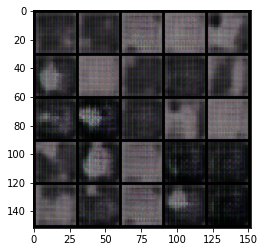

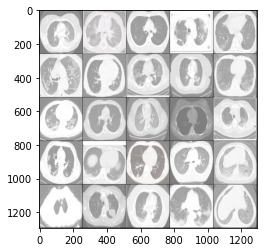

Step 10200: Generator loss: 0.2777172993421553, discriminator loss: 0.27722006523609166


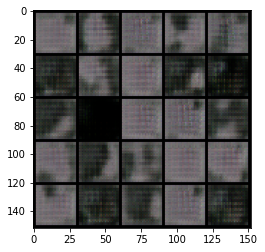

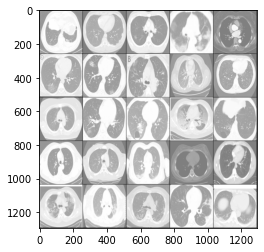

Step 10400: Generator loss: 0.27769792509078994, discriminator loss: 0.27730222737789134


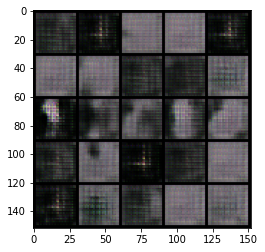

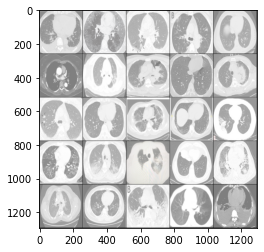

Step 10600: Generator loss: 0.27776510155200945, discriminator loss: 0.27738094675540925


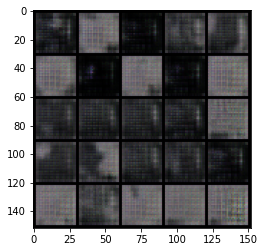

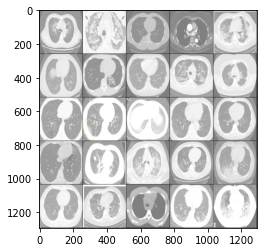

Step 10800: Generator loss: 0.27772964990139015, discriminator loss: 0.2772447787523268


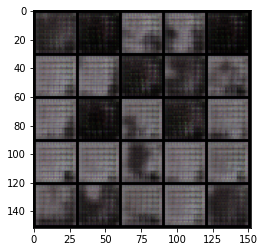

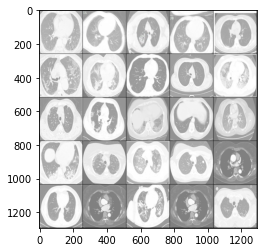

Step 11000: Generator loss: 0.2778811286687851, discriminator loss: 0.27717637026309966


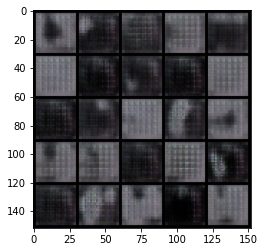

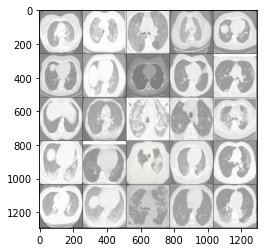

Step 11200: Generator loss: 0.27798926711082467, discriminator loss: 0.27716152513027204


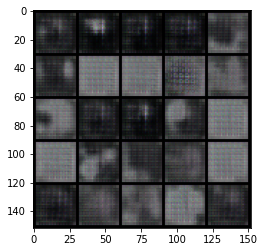

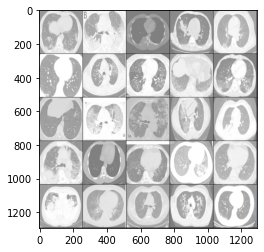

Step 11400: Generator loss: 0.27753639900684374, discriminator loss: 0.2771968585252762


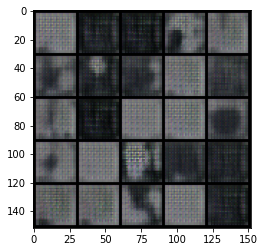

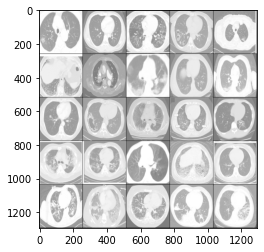

Step 11600: Generator loss: 0.2778022348880769, discriminator loss: 0.27725347542762757


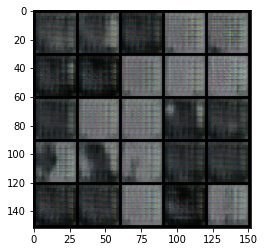

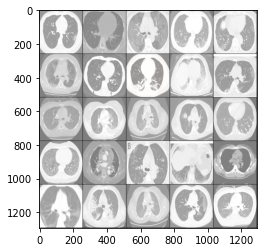

Step 11800: Generator loss: 0.2786979632377624, discriminator loss: 0.2772020852565766


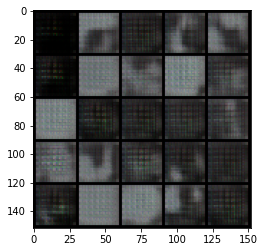

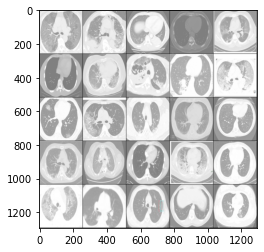

Step 12000: Generator loss: 0.277535926580429, discriminator loss: 0.2773124334812163


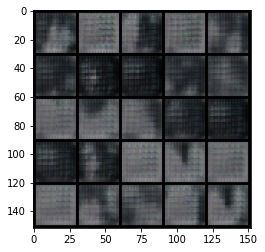

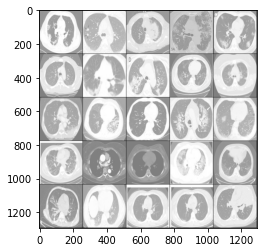

Step 12200: Generator loss: 0.278179477095604, discriminator loss: 0.277163010239601


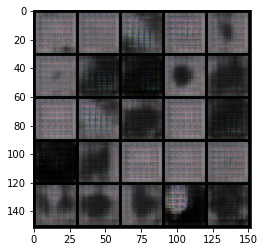

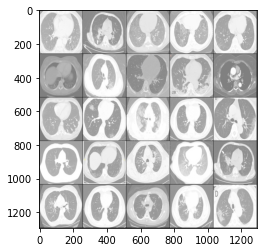

Step 12400: Generator loss: 0.27789012014865877, discriminator loss: 0.2772354152202606


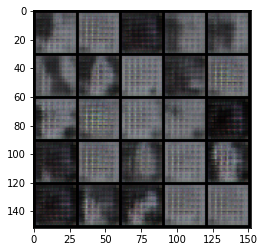

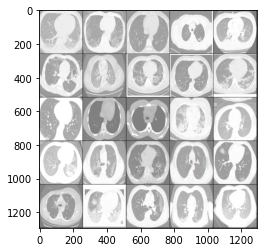

Step 12600: Generator loss: 0.27799317955970765, discriminator loss: 0.2771441501379013


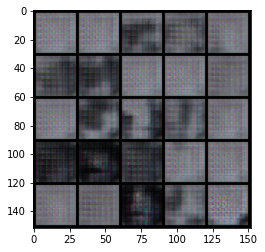

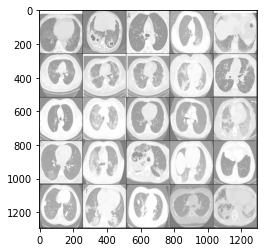

Step 12800: Generator loss: 0.2776187486648559, discriminator loss: 0.2772637735605242


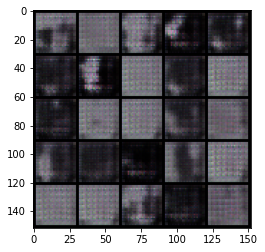

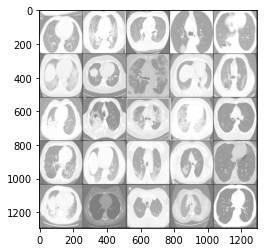

Step 13000: Generator loss: 0.2779871345758439, discriminator loss: 0.2772705088853835


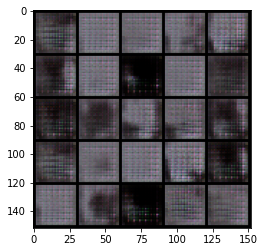

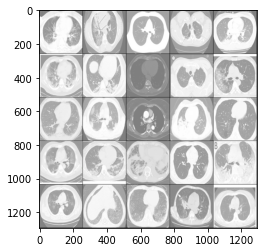

Step 13200: Generator loss: 0.2776484994888306, discriminator loss: 0.27742840170860295


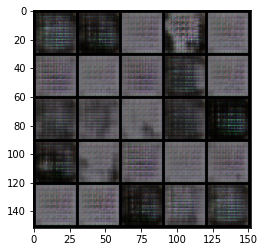

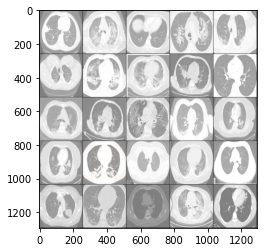

Step 13400: Generator loss: 0.2777790796756745, discriminator loss: 0.27729238712787646


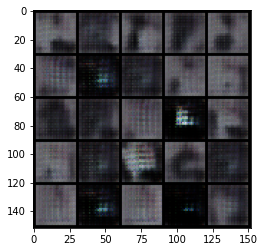

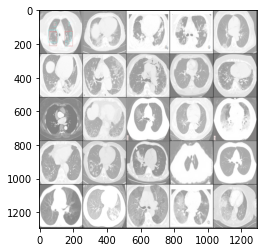

Step 13600: Generator loss: 0.27778160929679885, discriminator loss: 0.2773115267753599


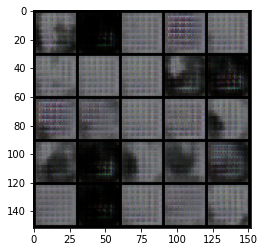

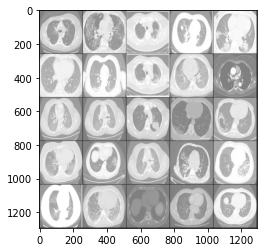

Step 13800: Generator loss: 0.2779440742731096, discriminator loss: 0.27729318320751173


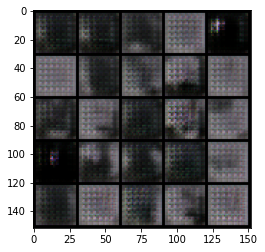

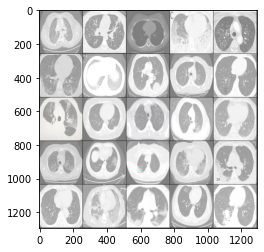

Step 14000: Generator loss: 0.27808059895038617, discriminator loss: 0.27719934821128833


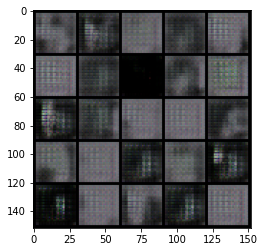

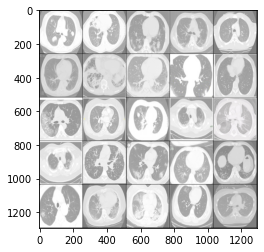

Step 14200: Generator loss: 0.2777893275022505, discriminator loss: 0.2771565465927124


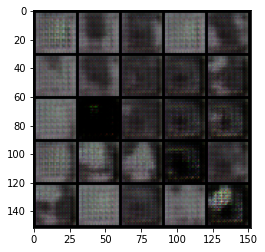

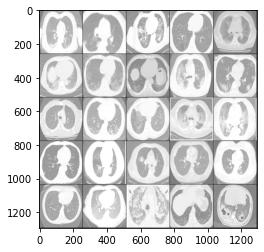

Step 14400: Generator loss: 0.2776862887144089, discriminator loss: 0.2772012573480603


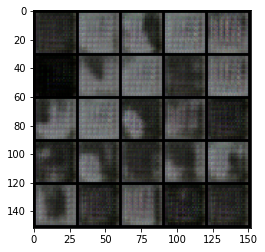

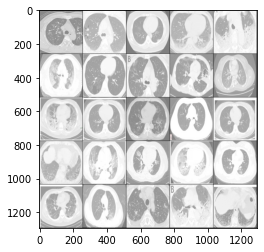

Step 14600: Generator loss: 0.2775872195959091, discriminator loss: 0.2772712564468383


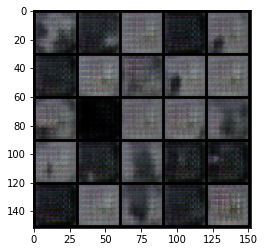

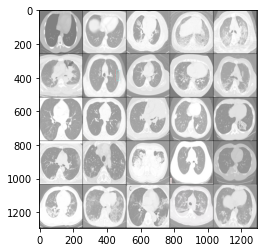

Step 14800: Generator loss: 0.2776646897792817, discriminator loss: 0.2772307890653609


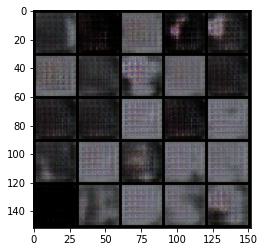

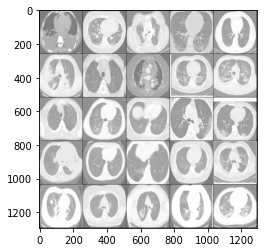

Step 15000: Generator loss: 0.2775997686386109, discriminator loss: 0.27719268476963044


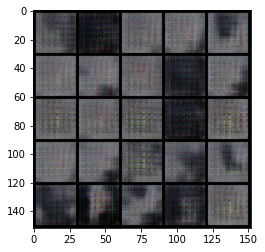

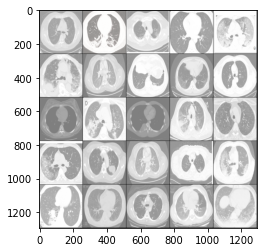

Step 15200: Generator loss: 0.27750074756145476, discriminator loss: 0.27720490181446067


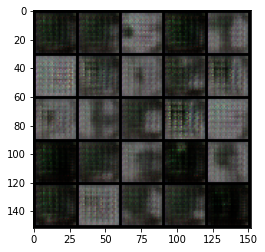

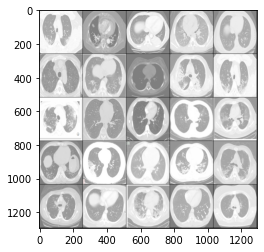

Step 15400: Generator loss: 0.27761399853229524, discriminator loss: 0.2771883591413498


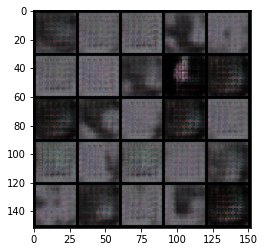

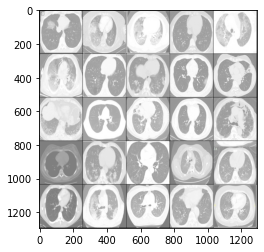

Step 15600: Generator loss: 0.2779085437059402, discriminator loss: 0.2772314924001694


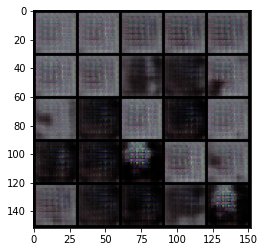

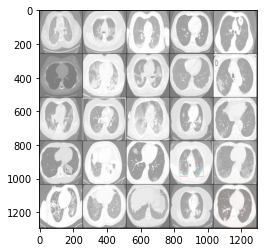

Step 15800: Generator loss: 0.2776671409606934, discriminator loss: 0.27727491748332966


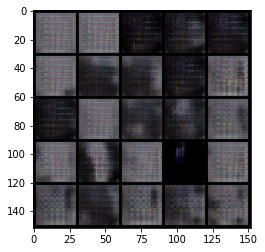

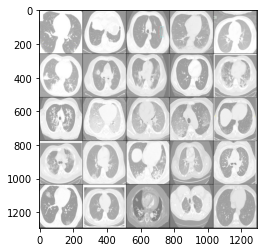

Step 16000: Generator loss: 0.27779564559459674, discriminator loss: 0.27718573641777056


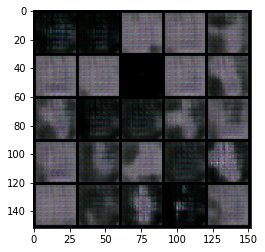

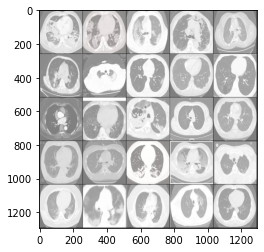

Step 16200: Generator loss: 0.2776729290485382, discriminator loss: 0.2771887946128845


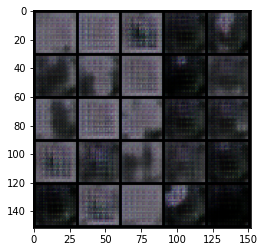

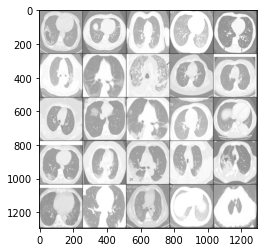

Step 16400: Generator loss: 0.2777444113492964, discriminator loss: 0.27722793757915476


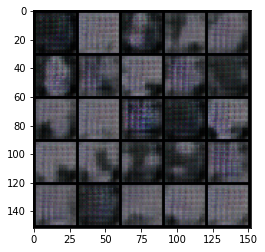

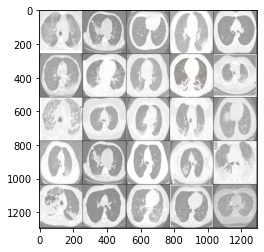

Step 16600: Generator loss: 0.2776691896915436, discriminator loss: 0.2772032313346864


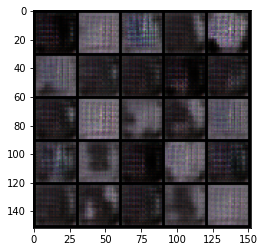

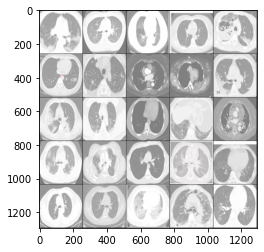

Step 16800: Generator loss: 0.2780608260631563, discriminator loss: 0.2772346057891847


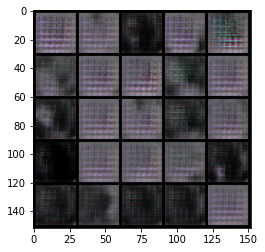

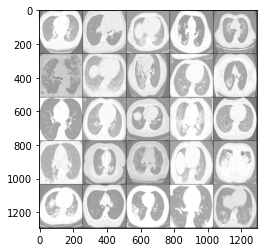

Step 17000: Generator loss: 0.2780257083177566, discriminator loss: 0.27722172355651836


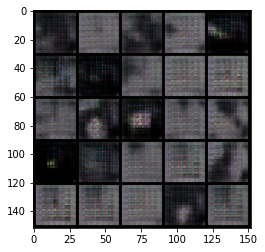

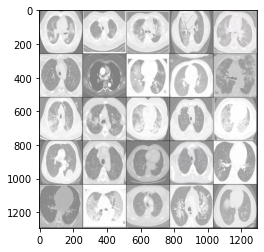

Step 17200: Generator loss: 0.27771353924274444, discriminator loss: 0.2772405120134353


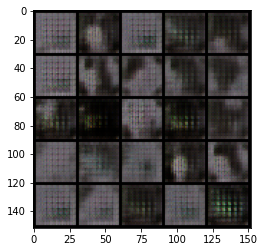

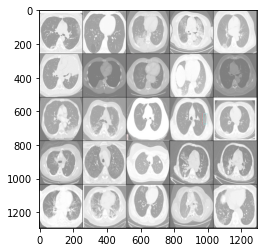

Step 17400: Generator loss: 0.27771756184101104, discriminator loss: 0.27721742379665393


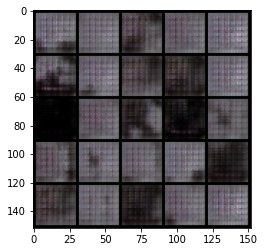

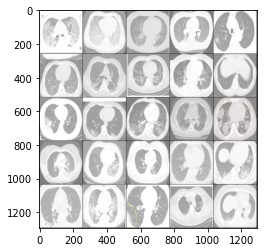

Step 17600: Generator loss: 0.2776407569646834, discriminator loss: 0.27719569051265713


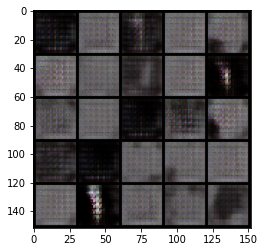

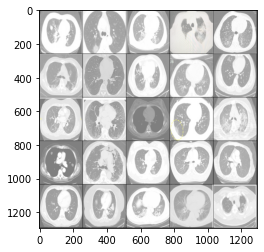

Step 17800: Generator loss: 0.2775361452102661, discriminator loss: 0.27719482529163364


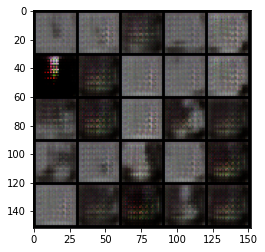

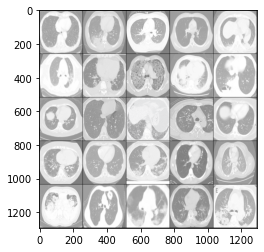

Step 18000: Generator loss: 0.2776532586812976, discriminator loss: 0.2772576171159744


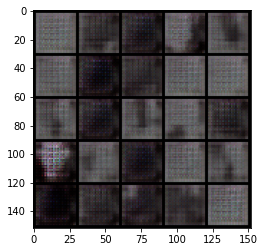

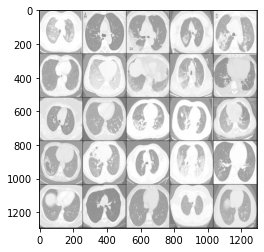

Step 18200: Generator loss: 0.27765649724006647, discriminator loss: 0.2771525135040282


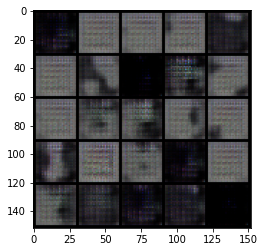

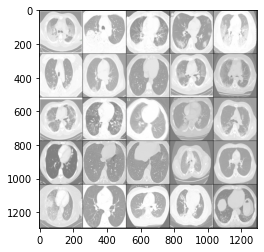

Step 18400: Generator loss: 0.27759733545780174, discriminator loss: 0.2772546590566636


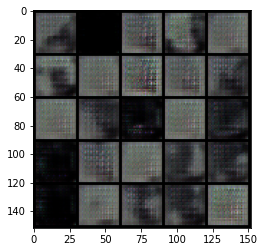

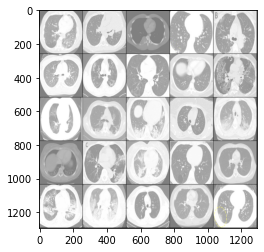

Step 18600: Generator loss: 0.27762280690670005, discriminator loss: 0.27724065268039694


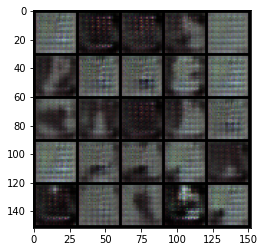

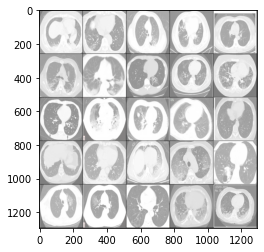

Step 18800: Generator loss: 0.2776029720306396, discriminator loss: 0.2772607485055923


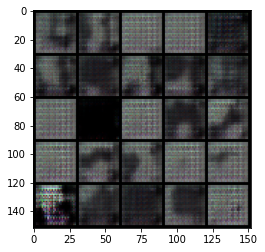

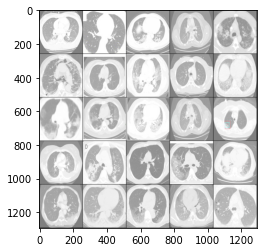

Step 19000: Generator loss: 0.277490402340889, discriminator loss: 0.27728443014621734


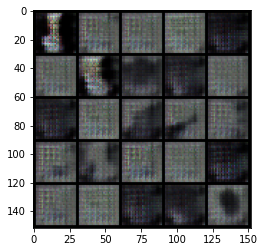

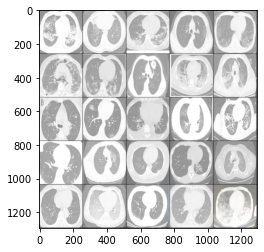

Step 19200: Generator loss: 0.27767065060138707, discriminator loss: 0.27718666362762456


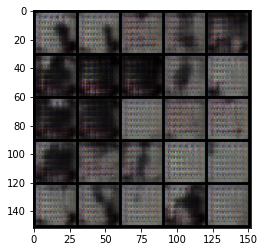

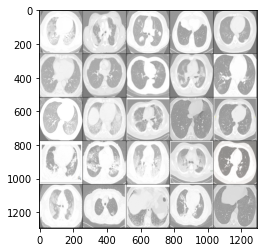

Step 19400: Generator loss: 0.2775667976140974, discriminator loss: 0.27724712049961087


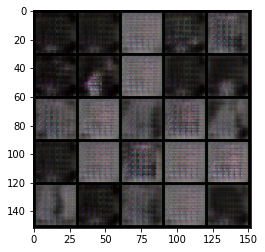

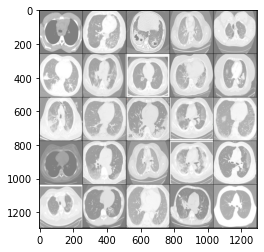

Step 19600: Generator loss: 0.2777045881748198, discriminator loss: 0.2772263375520707


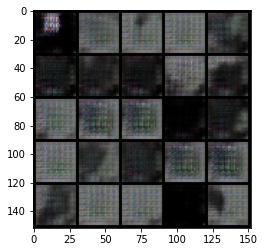

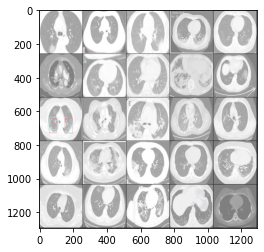

Step 19800: Generator loss: 0.2776477411985398, discriminator loss: 0.27727400910854333


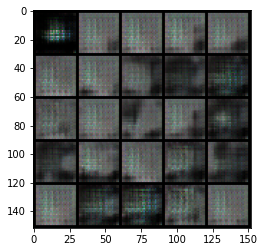

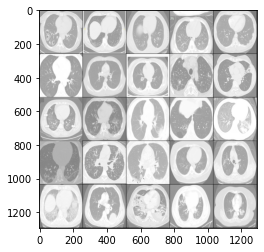

Step 20000: Generator loss: 0.27778321754932417, discriminator loss: 0.2771616995334626


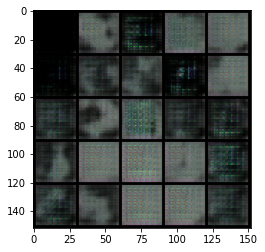

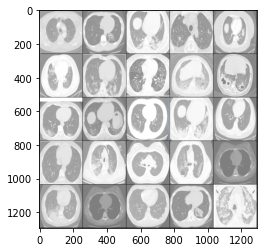

Step 20200: Generator loss: 0.2776063079833986, discriminator loss: 0.277270604968071


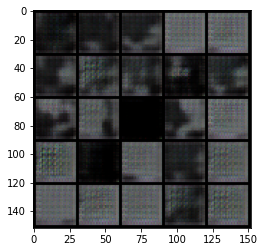

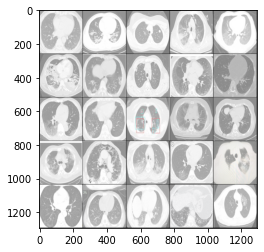

Step 20400: Generator loss: 0.2775347006320953, discriminator loss: 0.2772223302125929


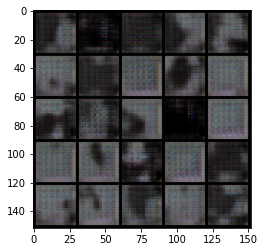

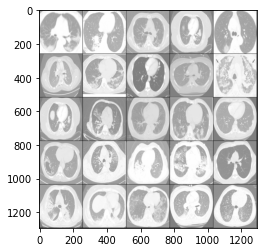

Step 20600: Generator loss: 0.2775191098451614, discriminator loss: 0.2772312257289886


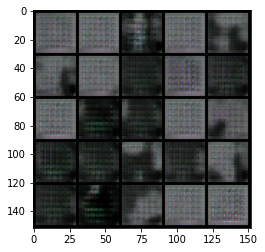

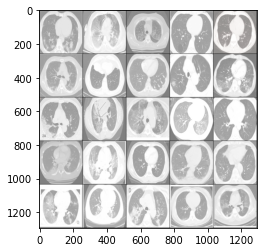

Step 20800: Generator loss: 0.27751348853111274, discriminator loss: 0.2772110192775725


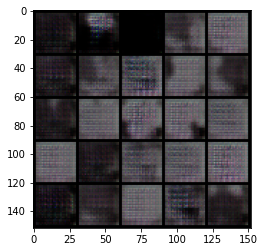

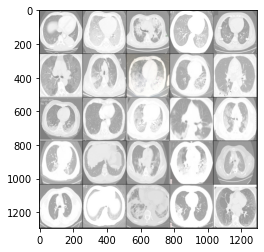

Step 21000: Generator loss: 0.2774841841459273, discriminator loss: 0.2772226160764692


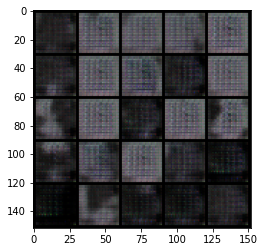

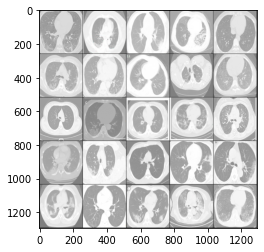

Step 21200: Generator loss: 0.27748666787147525, discriminator loss: 0.2772289962768556


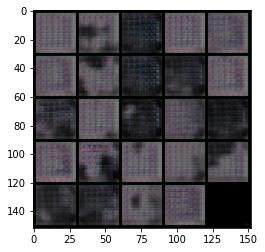

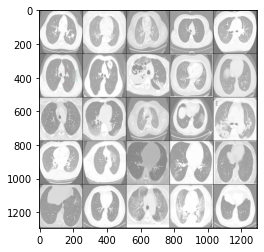

Step 21400: Generator loss: 0.2775719015598295, discriminator loss: 0.27718589472770694


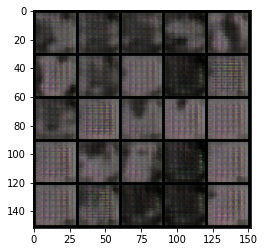

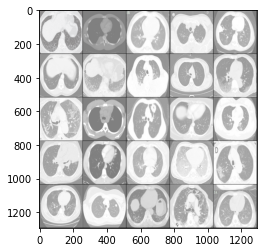

Step 21600: Generator loss: 0.2776534361839294, discriminator loss: 0.27722329425811765


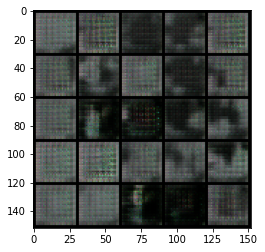

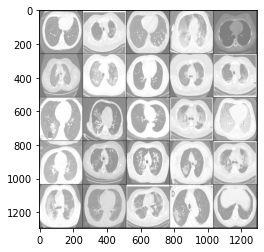

Step 21800: Generator loss: 0.2777479919195175, discriminator loss: 0.2771911729574202


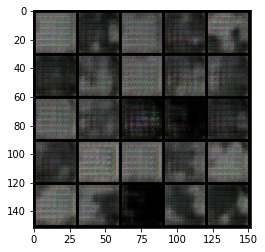

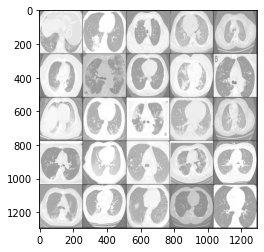

Step 22000: Generator loss: 0.277829337477684, discriminator loss: 0.27717000579834006


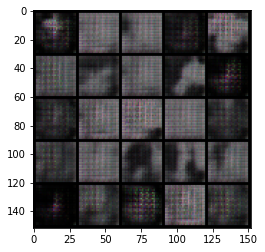

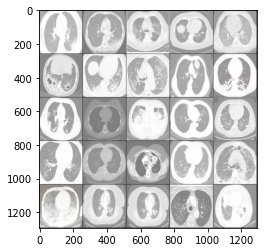

Step 22200: Generator loss: 0.27754873335361474, discriminator loss: 0.2772563046216964


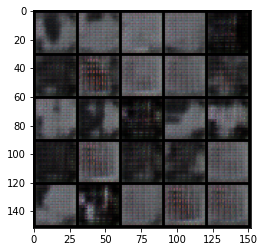

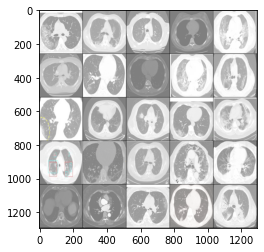

Step 22400: Generator loss: 0.2777381244897842, discriminator loss: 0.2772410567998884


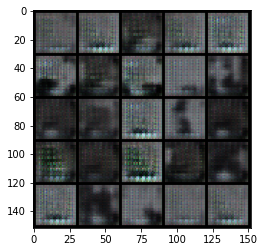

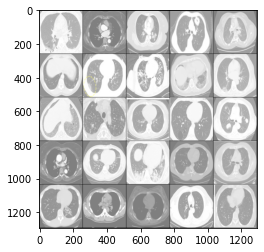

Step 22600: Generator loss: 0.2776828721761703, discriminator loss: 0.2772779120206833


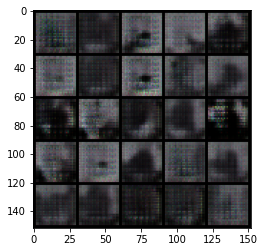

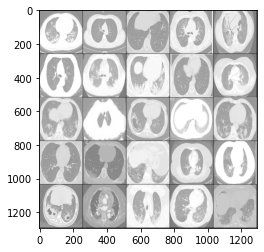

Step 22800: Generator loss: 0.2777447978258135, discriminator loss: 0.2772126282453537


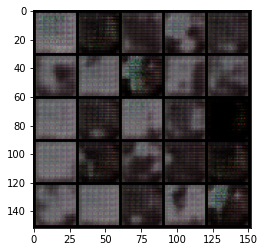

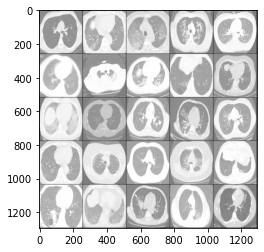

Step 23000: Generator loss: 0.27758233451843245, discriminator loss: 0.2772325619459153


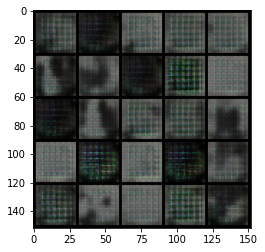

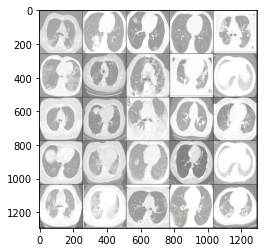

Step 23200: Generator loss: 0.2775418279170989, discriminator loss: 0.27722899782657623


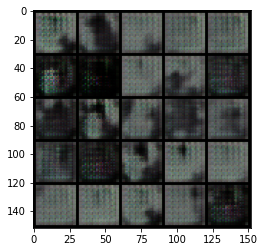

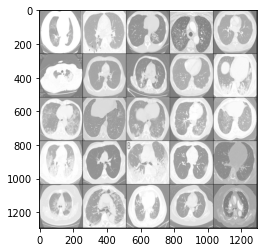

Step 23400: Generator loss: 0.27761657869815815, discriminator loss: 0.2772458326816559


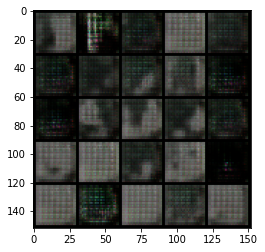

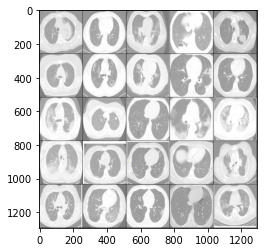

Step 23600: Generator loss: 0.27780353391170504, discriminator loss: 0.27719897389411924


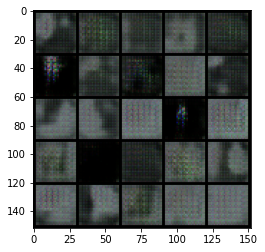

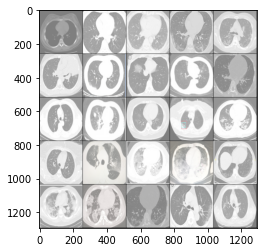

Step 23800: Generator loss: 0.27767409157753004, discriminator loss: 0.277224866747856


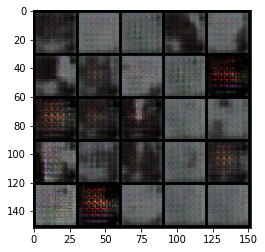

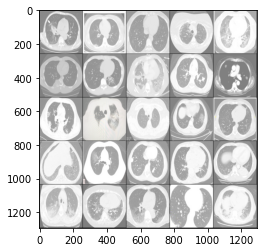

In [ ]:
n_epochs = 6000
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in train_loader:
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update discriminator ##
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(fake_noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_pred = disc(real)
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update generator ##
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % 200 == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1